## Import dependencies

In [10]:
import io
import os
from urllib.parse import urlparse
import numpy as np
import boto3
import pystac_client
from dotenv import load_dotenv
from PIL import Image
import random


## Setup and Environment Configuration

First, we'll import the required libraries and set up our environment. Make sure your Copernicus credentials are stored in your environment variables or a `.env` file.


In [11]:
# Get credentials from environment variables
load_dotenv()
ACCESS_KEY_ID = os.environ.get("ACCESS_KEY_ID")
SECRET_ACCESS_KEY = os.environ.get("SECRET_ACCESS_KEY")
ENDPOINT_URL = 'https://eodata.dataspace.copernicus.eu'
ENDPOINT_STAC = "https://stac.dataspace.copernicus.eu/v1/"
BUCKET_NAME = "eodata"
LON, LAT = 150.97, -20.92

In [12]:
class S3Connector:
    """A clean connector for S3-compatible storage services"""

    def __init__(self, endpoint_url, access_key_id,
                 secret_access_key, region_name='default'):
        """Initialize the S3Connector with connection parameters"""
        self.endpoint_url = endpoint_url
        self.access_key_id = access_key_id
        self.secret_access_key = secret_access_key
        self.region_name = region_name

        # Create session
        self.session = boto3.session.Session()

        # Initialize S3 resource
        self.s3 = self.session.resource(
            's3',
            endpoint_url=self.endpoint_url,
            aws_access_key_id=self.access_key_id,
            aws_secret_access_key=self.secret_access_key,
            region_name=self.region_name
        )

        # Initialize S3 client
        self.s3_client = self.session.client(
            's3',
            endpoint_url=self.endpoint_url,
            aws_access_key_id=self.access_key_id,
            aws_secret_access_key=self.secret_access_key,
            region_name=self.region_name
        )

    def get_s3_client(self):
        """Get the boto3 S3 client"""
        return self.s3_client

    def get_s3_resource(self):
        """Get the boto3 S3 resource"""
        return self.s3

    def get_bucket(self, bucket_name):
        """Get a specific bucket by name"""
        return self.s3.Bucket(bucket_name)

    def list_buckets(self):
        """List all available buckets"""
        response = self.s3_client.list_buckets()
        if 'Buckets' in response:
            return [bucket['Name'] for bucket in response['Buckets']]
        return []

In [13]:
def extract_s3_path_from_url(url):
    """
    Extracts the S3 object path from an S3 URL or URI.

    This function parses S3 URLs/URIs and returns just the object path portion,
    removing the protocol (s3://), bucket name, and any leading slashes.

    Args:
        url (str): The full S3 URI (e.g., 's3://eodata/path/to/file.jp2')

    Returns:
        str: The S3 object path (without protocol, bucket name and leading slashes)
    """
    # If it's not an S3 URI, return it unchanged
    if not url.startswith('s3://'):
        return url

    # Parse the S3 URI
    parsed_url = urlparse(url)

    # Ensure this is an S3 URL
    if parsed_url.scheme != 's3':
        raise ValueError(f"URL {url} is not an S3 URL")

    # Extract the path without leading slashes
    object_path = parsed_url.path.lstrip('/')

    return object_path

In [14]:
def get_product(s3_resource, bucket_name, object_url, output_path):
    """
    Download a product from S3 bucket and create output directory if it doesn't exist.

    Args:
        s3_resource: boto3 S3 resource object
        bucket_name (str): Name of the S3 bucket
        object_url (str): Path to the object within the bucket
        output_path (str): Local directory to save the file

    Returns:
        str: Path to the downloaded file
    """
    # Create output directory if it doesn't exist
    os.makedirs(output_path, exist_ok=True)

    # Extract filename from the object URL
    _, filename = os.path.split(object_url)

    # Full path where the file will be saved
    local_file_path = os.path.join(output_path, filename)

    print(f"Downloading {object_url} to {local_file_path}...")

    try:
        # Download the file from S3
        s3_resource.Bucket(bucket_name).download_file(object_url, local_file_path)
        print(f"Successfully downloaded to {local_file_path}")
    except Exception as e:
        print(f"Error downloading file: {str(e)}")
        raise

    return local_file_path

def get_product_content(s3_client, bucket_name, object_url):
    """
    Download the content of a product from S3 bucket.

    Args:
        s3_client: boto3 S3 client object
        bucket_name (str): Name of the S3 bucket
        object_url (str): Path to the object within the bucket

    Returns:
        bytes: Content of the downloaded file
    """
    print(f"Downloading {object_url}...")

    try:
        # Download the file from S3
        response = s3_client.get_object(Bucket=bucket_name, Key=object_url)
        content = response['Body'].read()
        print(f"Successfully downloaded {object_url}")
    except Exception as e:
        print(f"Error downloading file: {str(e)}")
        raise

    return content

In [15]:
catalog = pystac_client.Client.open(ENDPOINT_STAC)
connector = S3Connector(
    endpoint_url=ENDPOINT_URL,
    access_key_id=ACCESS_KEY_ID,
    secret_access_key=SECRET_ACCESS_KEY,
    region_name='default'
)
# Get S3 client and resource from the connector instance
s3 = connector.get_s3_resource()
s3_client = connector.get_s3_client()
buckets = connector.list_buckets()
print("Available buckets:", buckets)

Available buckets: ['DIAS', 'EODATA']


In [16]:
# Search for Sentinel-2 products
items_txt = catalog.search(
    collections=['sentinel-2-l2a'],
    intersects=dict(type="Point", coordinates=[LON, LAT]),
    datetime="2024-05-01/2024-06-01",
    query=["eo:cloud_cover<50"]
).item_collection()
selected_item = random.choice(items_txt)
selected_item

<Item id=S2A_MSIL2A_20240511T001111_N0510_R073_T56KKB_20240511T025552>

In [18]:
bucket = s3.Bucket(BUCKET_NAME)
product_url = extract_s3_path_from_url(selected_item.assets['TCI_60m'].href)
# file_path = get_product(s3_resource=s3, bucket_name=BUCKET_NAME,
#                              object_url=product_url,
#                              output_path=".")
product_content = get_product_content(s3_client=s3_client, bucket_name=BUCKET_NAME,
                                     object_url=product_url)

Successfully downloaded Sentinel-2/MSI/L2A/2024/05/11/S2A_MSIL2A_20240511T001111_N0510_R073_T56KKB_20240511T025552.SAFE/GRANULE/L2A_T56KKB_A046402_20240511T001113/IMG_DATA/R60m/T56KKB_20240511T001111_TCI_60m.jp2


Successfully downloaded product: Sentinel-2/MSI/L2A/2024/05/11/S2A_MSIL2A_20240511T001111_N0510_R073_T56KKB_20240511T025552.SAFE/GRANULE/L2A_T56KKB_A046402_20240511T001113/IMG_DATA/R60m/T56KKB_20240511T001111_TCI_60m.jp2


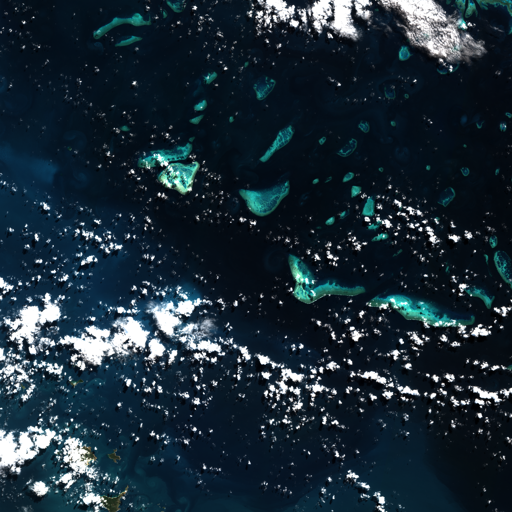

In [19]:
print(f"Successfully downloaded product: {product_url}")
image = Image.open(io.BytesIO(product_content))
resized_image = image.resize((512, 512))
resized_image

### Boundinx Box Search

In [21]:
# Define bounding box coordinates [min_lon, min_lat, max_lon, max_lat]
bbox  = [150.47, -21.42, 151.47, -20.42]

# Search for Sentinel-2 products within the bounding box
items_txt = catalog.search(
    collections=['sentinel-2-l2a'],
    bbox=bbox,
    datetime="2024-05-01/2024-06-01",
    query=["eo:cloud_cover<30"]
).item_collection()
items_txt

Successfully downloaded Sentinel-2/MSI/L2A/2024/05/31/S2A_MSIL2A_20240531T001111_N0510_R073_T56KLB_20240531T042453.SAFE/GRANULE/L2A_T56KLB_A046688_20240531T001113/IMG_DATA/R60m/T56KLB_20240531T001111_TCI_60m.jp2


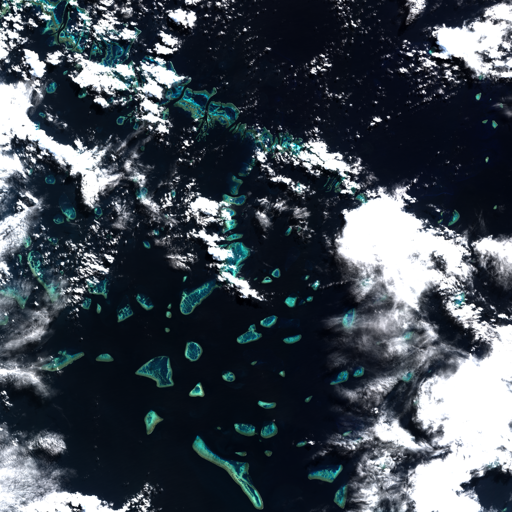

In [23]:
BUCKET_NAME = "eodata"
bucket = s3.Bucket(BUCKET_NAME)
selected_item = random.choice(items_txt)
product_url = extract_s3_path_from_url(selected_item.assets['TCI_60m'].href)
# file_path = get_product(s3_resource=s3, bucket_name=BUCKET_NAME,
#                              object_url=product_url,
#                              output_path=".")
product_content = get_product_content(s3_client=s3_client, bucket_name=BUCKET_NAME,
                                     object_url=product_url)
image = Image.open(io.BytesIO(product_content))
resized_image = image.resize((512, 512))
resized_image

### Random Lon Lat generation

In [39]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import random
from shapely.geometry import Point

# Load land data
import geodatasets
natural_earth_path = geodatasets.get_path("naturalearth.land")
land = gpd.read_file(natural_earth_path)

# Option 1: Select a random point on land
def get_random_land_point():
    # Select a random land polygon
    random_land = land.sample(1)

    # Get the geometry (polygon or multipolygon)
    geom = random_land.geometry.iloc[0]

    # Find a point within the polygon
    minx, miny, maxx, maxy = geom.bounds

    # Keep trying until we get a point inside the polygon
    while True:
        random_point_x = random.uniform(minx, maxx)
        random_point_y = random.uniform(miny, maxy)
        point = Point(random_point_x, random_point_y)

        if geom.contains(point):
            return random_point_x, random_point_y  # Return lon, lat

# Option 2: Get points within land polygons WITHOUT using centroid
# This completely avoids the warning messages
land_points = land.copy()
# Use representative_point instead of centroid - this guarantees the point is within the polygon
land_points['point'] = land_points.geometry.representative_point()
land_points['lon'] = land_points.point.x
land_points['lat'] = land_points.point.y

# Generate one random point on land
random_lon, random_lat = get_random_land_point()
print(f"Random point on land - Lon: {random_lon}, Lat: {random_lat}")

Random point on land - Lon: 110.22846226209941, Lat: 18.758459302446056


In [40]:
import folium

# Create a folium map centered at the random point
m = folium.Map(location=[random_lat, random_lon], zoom_start=10)

# Add a marker for the random point
folium.Marker(
    location=[random_lat, random_lon],
    popup=f"Random Point<br>Lon: {random_lon:.6f}<br>Lat: {random_lat:.6f}",
    icon=folium.Icon(color='red', icon='info-sign')
).add_to(m)

# Display the map
m

In [41]:
LON, LAT = random_lon, random_lat

# Search for Sentinel-2 products
items_txt = catalog.search(
    collections=['sentinel-2-l2a'],
    intersects=dict(type="Point", coordinates=[LON, LAT]),
    datetime="2024-01-01/2024-06-01",
    query=["eo:cloud_cover<50"]
).item_collection()

In [42]:
items_txt

Successfully downloaded Sentinel-2/MSI/L2A/2024/02/06/S2B_MSIL2A_20240206T030919_N0510_R075_T49QDA_20240206T052440.SAFE/GRANULE/L2A_T49QDA_A036137_20240206T032110/IMG_DATA/R60m/T49QDA_20240206T030919_TCI_60m.jp2


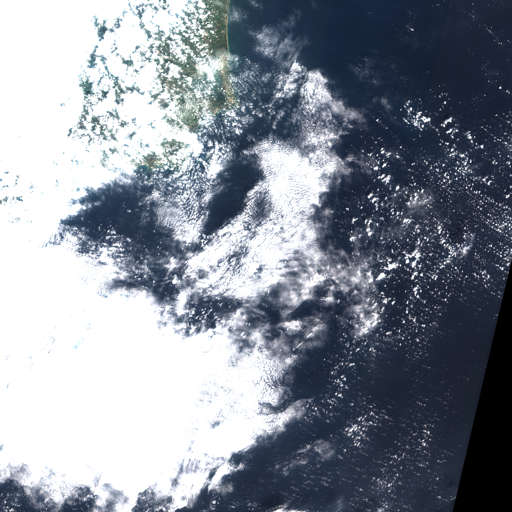

In [43]:

BUCKET_NAME = "eodata"
bucket = s3.Bucket(BUCKET_NAME)
selected_item = random.choice(items_txt)
product_url = extract_s3_path_from_url(selected_item.assets['TCI_60m'].href)
# file_path = get_product(s3_resource=s3, bucket_name=BUCKET_NAME,
#                              object_url=product_url,
#                              output_path=".")
product_content = get_product_content(s3_client=s3_client, bucket_name=BUCKET_NAME,
                                     object_url=product_url)
image = Image.open(io.BytesIO(product_content))
resized_image = image.resize((512, 512))
resized_image

In [ ]:
###

Image shape: (3, 1830, 1830)
Image dimensions: 1830x1830
CRS: EPSG:32649



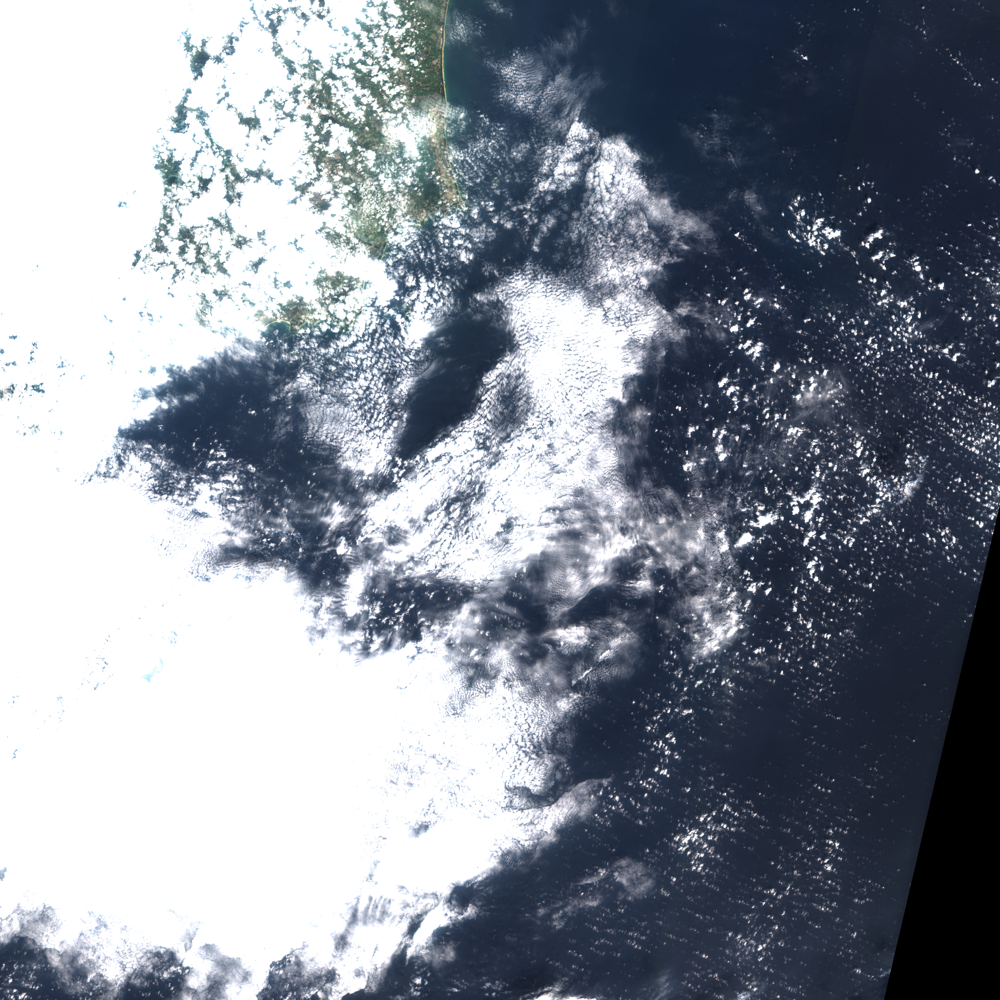

In [44]:
import rasterio
from rasterio.io import MemoryFile
import numpy as np
import folium
from folium import raster_layers
import io
from base64 import b64encode
from rasterio.io import MemoryFile
import matplotlib.pyplot as plt
from rasterio.warp import transform_bounds

# Create a folium map centered at the random point
m = folium.Map(location=[random_lat, random_lon], zoom_start=10)

# Add a marker for the random point
folium.Marker(
    location=[random_lat, random_lon],
    popup=f"Random Point<br>Lon: {random_lon:.6f}<br>Lat: {random_lat:.6f}",
    icon=folium.Icon(color='red', icon='info-sign')
).add_to(m)

# Open with rasterio instead of PIL
with MemoryFile(product_content) as memfile:
    with memfile.open() as dataset:
        # Read the image data
        img_data = dataset.read()

        # Get image metadata
        height = dataset.height
        width = dataset.width
        crs = dataset.crs
        transform = dataset.transform

        print(f"Image shape: {img_data.shape}")
        print(f"Image dimensions: {width}x{height}")
        print(f"CRS: {crs}")

        # Get the bounds of the image in the original CRS
        src_bounds = dataset.bounds

        # Convert bounds to WGS84 (latitude/longitude) for folium
        # Folium expects bounds in [lat_min, lon_min, lat_max, lon_max] format
        if crs != 'EPSG:4326':  # If not already in WGS84
            # Get bounds in WGS84 (EPSG:4326) which folium uses
            bounds = transform_bounds(
                src_crs=crs,
                dst_crs='EPSG:4326',
                left=src_bounds.left,
                bottom=src_bounds.bottom,
                right=src_bounds.right,
                top=src_bounds.top
            )
        else:
            bounds = [src_bounds.left, src_bounds.bottom, src_bounds.right, src_bounds.top]

        # Convert to [lat_min, lon_min, lat_max, lon_max] for folium
        folium_bounds = [[bounds[1], bounds[0]], [bounds[3], bounds[2]]]

        # For RGB true color composite
        rgb = np.dstack((img_data[0], img_data[1], img_data[2]))

        # Save the image to a BytesIO buffer
        img_buffer = io.BytesIO()
        plt.imsave(img_buffer, rgb, format='png')
        img_buffer.seek(0)

        # Create a base64 encoded string of the image
        img_str = b64encode(img_buffer.read()).decode()

        # Add the image overlay to the map
        image_overlay = folium.raster_layers.ImageOverlay(
            image=f"data:image/png;base64,{img_str}",
            bounds=folium_bounds,
            opacity=0.7,
            name="Sentinel-2 Image"
        )
        image_overlay.add_to(m)

        # Add layer control
        folium.LayerControl().add_to(m)

# Display the map
m